In [1]:
import os,sys
sys.path.append(os.path.realpath(os.path.join(os.getcwd(), '..')))
import warnings
warnings.filterwarnings("ignore")

In [2]:
import scanpy as sc
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import CPS

In [3]:
opt = CPS.config()
args = opt.parse_args(['--seed', '2025'])
args.prep_scale = True
args.dataset_path = '/mnt/d/Dataset/SRT_Dataset/VHD/'
args.radius=50
args.max_neighbors = 8
args.batch_size=4096
args.max_epoch=20
args.lr=1e-3
args.hvgs=2000
args.sigma=5
args.freq=32
args.er_w=1.
CPS.set_random_seed(args.seed)
args.k_list = [0,1,2,3,5,8,13,21]
# [0,1,2,3,4,5,6,7][0,1,2,3,5,8,13,21][0,1,2,4,6,8,10,12][0,1,2,4,8,16,32,64]
args

Namespace(batch_size=4096, clusters=7, coord_dim=2, dataset_path='/mnt/d/Dataset/SRT_Dataset/VHD/', decoder_latent=[256, 512, 1024], distill=1.0, dropout=0.2, embedd_dim=512, er_w=1.0, flow='source_to_target', freq=32, gpu=0, hvgs=2000, inr_latent=[256, 256, 256], k_list=[0, 1, 2, 3, 5, 8, 13, 21], latent_dim=64, lr=0.001, max_epoch=20, max_neighbors=8, n_spot=0, num_heads=4, prep_scale=True, radius=50, seed=2025, self_loops=True, sigma=5, weight_decay=0.0001)

In [4]:
position_file = args.dataset_path+'binned_outputs/square_008um/spatial/tissue_positions.parquet'
position_csv = args.dataset_path+'binned_outputs/square_008um/spatial/tissue_positions_list.csv'
if  not os.path.exists(position_csv):
    tissue_position_df = pd.read_parquet(position_file)
    tissue_position_df.to_csv(position_csv, index=False, header=None)
adata = sc.read_visium(path = args.dataset_path+'binned_outputs/square_008um')
adata

AnnData object with n_obs × n_vars = 393543 × 19059
    obs: 'in_tissue', 'array_row', 'array_col'
    var: 'gene_ids', 'feature_types', 'genome'
    uns: 'spatial'
    obsm: 'spatial'

In [5]:
adata.var_names_make_unique()
adata.layers["counts"] = adata.X.copy()
sc.pp.highly_variable_genes(adata, flavor="seurat_v3", n_top_genes=args.hvgs)
adata_hvg = adata[:, adata.var['highly_variable']].copy()
sc.pp.normalize_total(adata_hvg, target_sum=1e4)
sc.pp.log1p(adata_hvg)
sc.pp.scale(adata_hvg, zero_center=True, max_value=10)

counts_layer = adata_hvg.layers['counts']
adata_hvg.obsm['hvg_features'] = adata_hvg.X
adata_hvg.obsm['hvg_counts'] = counts_layer.toarray()

In [6]:
spatial_edge = CPS.SpatialGraphBuilder(args)
pyg_data = spatial_edge.build_large_graph(adata_hvg, method='rknn')
print(pyg_data.num_nodes, pyg_data.num_genes, pyg_data.edge_index.shape)

393543 2000 torch.Size([2, 3531849])


In [7]:
from CPS.module import MultiHopSGConv
from sklearn.decomposition import TruncatedSVD
from sklearn.preprocessing import StandardScaler
import torch
tokenizer = MultiHopSGConv(k_list=args.k_list, prep_scale=True)
input_feat = pyg_data.x.cpu().numpy()
svd = TruncatedSVD(n_components=64, algorithm='randomized', random_state=42)
x_reduced = svd.fit_transform(input_feat)
scaler = StandardScaler()
x_reduced = scaler.fit_transform(x_reduced)
pyg_data.x = torch.from_numpy(x_reduced).float()
tokens = tokenizer(pyg_data.x, pyg_data.edge_index)
pyg_data.x = tokens

In [8]:
tokens.shape

torch.Size([393543, 8, 64])

In [9]:
cps_model = CPS.CPSTrainer(args, input_dim=64)
cps_model.efficient_fit(pyg_data, print_every=1)

  0%|          | 0/20 [00:00<?, ?it/s]

1.0394141674041748 2.079134941101074
1.0394313335418701 2.0791521072387695
1.0394079685211182 2.0791287422180176
1.0394032001495361 2.0791239738464355
1.039384365081787 2.0791051387786865
1.0393707752227783 2.0790915489196777
1.0393290519714355 2.079049825668335
1.0393126010894775 2.079033374786377
1.0392708778381348 2.078991651535034
1.0392203330993652 2.0789411067962646
1.0391995906829834 2.078920364379883
1.0390956401824951 2.0788164138793945
1.0389881134033203 2.0787088871002197
1.0389492511749268 2.078670024871826
1.0387895107269287 2.078510284423828
1.0386674404144287 2.078388214111328
1.0383453369140625 2.078066110610962
1.0382370948791504 2.07795786857605
1.0376150608062744 2.077335834503174
1.0373876094818115 2.077108383178711
1.0369977951049805 2.07671856880188
1.0365617275238037 2.076282501220703
1.0357685089111328 2.0754892826080322
1.0342686176300049 2.0739893913269043
1.032949686050415 2.0726704597473145
1.0317890644073486 2.071509838104248
1.0291976928710938 2.0689184665

In [10]:
z_s, latent, attn = cps_model.interpret_attn_scores(pyg_data, verbose=False)
adata_hvg.obsm['z_s'] = z_s
adata_hvg.obsm['z_t'] = latent
adata_hvg.obsm['attns'] = attn
adata_hvg.obsm['attn'] = attn.reshape(adata_hvg.n_obs, 32)

0.0 0.8401726484298706


In [11]:
x = pyg_data.x
pos = pyg_data.pos

edge_index = pyg_data.edge_index

cps_model.model.to('cpu')
z_teacher, attn, er_loss = cps_model.model.teacher(x, edge_index)

0.0 0.8401725888252258


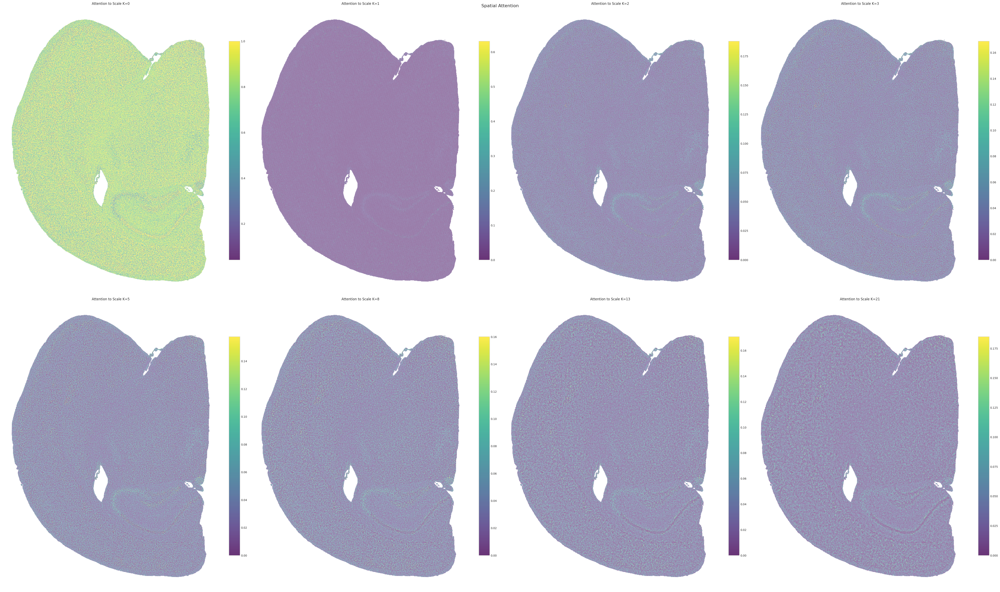

In [12]:
attn_avg_heads = attn.mean(axis=-1).cpu().detach().numpy()
pos = pyg_data.pos.cpu().numpy()
pos_cpu = pos

n_scales = len([0,1,2,3,5,8,13,21])
# fig, axes = plt.subplots(2, n_scales, figsize=(5 * n_scales, 5))
fig, axes = plt.subplots(2, 4, figsize=(50, 30))
if n_scales == 1:
    axes = [axes]
axes_flat = axes.flatten()
for i, k in enumerate([0,1,2,3,5,8,13,21]):
    ax = axes_flat[i]
    sc = ax.scatter(pos_cpu[:, 0], pos_cpu[:, 1],
                    c=attn_avg_heads[:, i],
                    cmap='viridis', s=0.1, alpha=0.8)
    ax.set_title(f"Attention to Scale K={k}")
    ax.axis('off')
    plt.colorbar(sc, ax=ax, fraction=0.046, pad=0.04)
    
plt.suptitle("Spatial Attention", fontsize=16)
plt.tight_layout()